<a href="https://colab.research.google.com/github/satish-1999/Fake_News_D/blob/main/FAKE_1st_text_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# import key libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
import nltk
import re
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize, sent_tokenize
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
import plotly.express as px

# Tensorflow
import tensorflow as tf
from tensorflow.keras.preprocessing.text import one_hot,Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Embedding, Input, LSTM, Conv1D, MaxPool1D, Bidirectional, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical

In [ ]:
# Mount the google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# install nltk
# NLTK: Natural Language tool kit
!pip install nltk

In [ ]:
# install gensim
# Gensim is an open-source library for unsupervised topic modeling and natural language processing
# Gensim is implemented in Python and Cython.
!pip install gensim

In [ ]:
# load the stock news data
data = pd.read_csv("/content/drive/MyDrive/FAKE NEWS/train.csv")
data.drop('author',axis=1)

,id,title,text,label
0,0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,0
2,2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",1
3,3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,1
4,4,Iranian woman jailed for fictional unpublished...,Print \nAn Iranian woman has been sentenced to...,1
...,...,...,...,...
20795,20795,Rapper T.I.: Trump a ’Poster Child For White S...,Rapper T. I. unloaded on black celebrities who...,0
20796,20796,"N.F.L. Playoffs: Schedule, Matchups and Odds -...",When the Green Bay Packers lost to the Washing...,0
20797,20797,Macy’s Is Said to Receive Takeover Approach by...,The Macy’s of today grew from the union of sev...,0
20798,20798,"NATO, Russia To Hold Parallel Exercises In Bal...","NATO, Russia To Hold Parallel Exercises In Bal...",1


In [ ]:
# Let's view the dataset 
data

,id,title,author,text,label
0,0,House Dem Aide: We Didn’t Even See Comey’s Let...,Darrell Lucus,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Daniel J. Flynn,Ever get the feeling your life circles the rou...,0
2,2,Why the Truth Might Get You Fired,Consortiumnews.com,"Why the Truth Might Get You Fired October 29, ...",1
3,3,15 Civilians Killed In Single US Airstrike Hav...,Jessica Purkiss,Videos 15 Civilians Killed In Single US Airstr...,1
4,4,Iranian woman jailed for fictional unpublished...,Howard Portnoy,Print \nAn Iranian woman has been sentenced to...,1
...,...,...,...,...,...
20795,20795,Rapper T.I.: Trump a ’Poster Child For White S...,Jerome Hudson,Rapper T. I. unloaded on black celebrities who...,0
20796,20796,"N.F.L. Playoffs: Schedule, Matchups and Odds -...",Benjamin Hoffman,When the Green Bay Packers lost to the Washing...,0
20797,20797,Macy’s Is Said to Receive Takeover Approach by...,Michael J. de la Merced and Rachel Abrams,The Macy’s of today grew from the union of sev...,0
20798,20798,"NATO, Russia To Hold Parallel Exercises In Bal...",Alex Ansary,"NATO, Russia To Hold Parallel Exercises In Bal...",1


In [ ]:
# dataframe information
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20800 entries, 0 to 20799
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      20800 non-null  int64 
 1   title   20242 non-null  object
 2   author  18843 non-null  object
 3   text    20761 non-null  object
 4   label   20800 non-null  int64 
dtypes: int64(2), object(3)
memory usage: 812.6+ KB


In [ ]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
data['text'][2]

'Why the Truth Might Get You Fired October 29, 2016 \nThe tension between intelligence analysts and political policymakers has always been between honest assessments and desired results, with the latter often overwhelming the former, as in the Iraq War, writes Lawrence Davidson. \nBy Lawrence Davidson \nFor those who might wonder why foreign policy makers repeatedly make bad choices, some insight might be drawn from the following analysis. The action here plays out in the United States, but the lessons are probably universal. \nBack in the early spring of 2003, George W. Bush initiated the invasion of Iraq. One of his key public reasons for doing so was the claim that the country’s dictator, Saddam Hussein, was on the verge of developing nuclear weapons and was hiding other weapons of mass destruction. The real reason went beyond that charge and included a long-range plan for “regime change” in the Middle East. President George W. Bush and Vice President Dick Cheney receive an Oval Off

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
import re
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
corpus = []
for i in range(0,20800):
  review = re.sub('[^a-zA-Z]', ' ', str(data['text'][i]))
  review = review.lower()
  review = review.split()
  ps = PorterStemmer()
  all_stopwords = stopwords.words('english')
  all_stopwords.remove('not')
  review = [ps.stem(word) for word in review if not word in set(all_stopwords)]
  review = ' '.join(review)
  corpus.append(review)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
# word_tokenize is used to break up a string into words
print(corpus[0])
print(nltk.word_tokenize(corpus[0]))

hous dem aid even see comey letter jason chaffetz tweet darrel lucu octob subscrib jason chaffetz stump american fork utah imag courtesi michael jolley avail creativ common licens apolog keith olbermann doubt worst person world week fbi director jame comey accord hous democrat aid look like also know second worst person well turn comey sent infam letter announc fbi look email may relat hillari clinton email server rank democrat relev committe hear comey found via tweet one republican committe chairmen know comey notifi republican chairmen democrat rank member hous intellig judiciari oversight committe agenc review email recent discov order see contain classifi inform not long letter went oversight committe chairman jason chaffetz set polit world ablaz tweet fbi dir inform fbi learn exist email appear pertin investig case reopen jason chaffetz jasoninthehous octob cours know not case comey actual say review email light unrel case know anthoni weiner sext teenag appar littl thing fact ma

In [ ]:
# Obtain the maximum length of data in the document
# This will be later used when word embeddings are generated
maxlen = -1
for doc in corpus:
    tokens = nltk.word_tokenize(doc)
    if(maxlen < len(tokens)):
        maxlen = len(tokens)
print("The maximum number of words in any document is:", maxlen)

The maximum number of words in any document is: 12247


In [ ]:
tweets_length = [ len(nltk.word_tokenize(x)) for x in corpus ]
tweets_length

[436,
 371,
 703,
 308,
 86,
 107,
 278,
 467,
 702,
 1014,
 869,
 295,
 265,
 145,
 3045,
 574,
 710,
 251,
 786,
 162,
 212,
 176,
 91,
 254,
 444,
 422,
 264,
 236,
 427,
 3468,
 270,
 664,
 685,
 909,
 623,
 949,
 1960,
 1739,
 231,
 485,
 295,
 423,
 318,
 101,
 247,
 568,
 310,
 6,
 224,
 212,
 537,
 308,
 190,
 65,
 28,
 466,
 132,
 813,
 835,
 991,
 671,
 31,
 701,
 243,
 375,
 349,
 905,
 188,
 172,
 104,
 710,
 3003,
 197,
 837,
 748,
 463,
 232,
 141,
 667,
 112,
 469,
 21,
 0,
 155,
 1097,
 136,
 18,
 696,
 172,
 450,
 532,
 296,
 703,
 505,
 113,
 442,
 640,
 155,
 762,
 712,
 15,
 549,
 488,
 298,
 202,
 281,
 319,
 94,
 224,
 375,
 800,
 145,
 103,
 624,
 819,
 257,
 443,
 544,
 538,
 812,
 14,
 438,
 478,
 670,
 50,
 39,
 1551,
 809,
 387,
 325,
 62,
 77,
 968,
 654,
 263,
 349,
 174,
 500,
 227,
 261,
 69,
 213,
 1,
 357,
 261,
 190,
 639,
 200,
 49,
 389,
 70,
 196,
 264,
 665,
 725,
 619,
 718,
 798,
 191,
 2432,
 739,
 446,
 16,
 27,
 131,
 414,
 574,
 523,
 107,
 0

In [ ]:
tweets_length[0]

436

In [ ]:
total_words=0
for x in tweets_length:
  total_words = total_words + tweets_length[x]
print(total_words)

9574295


In [ ]:
# Plot the distribution for the number of words in a text
fig = px.histogram(x = tweets_length, nbins = 100)
fig.show()

In [ ]:
# split the data into test and train 
X = corpus


In [ ]:
y=data['label']

In [ ]:
set(y)

{0, 1}

In [ ]:
len(y)

20800

In [ ]:
y

0        1
1        0
2        1
3        1
4        1
        ..
20795    0
20796    0
20797    0
20798    1
20799    1
Name: label, Length: 20800, dtype: int64

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.1)

In [ ]:
len(X_train)

18720

In [ ]:
len(X_test)

2080

In [ ]:
X_train

['podesta email reveal extent bill clinton profit activ podesta email reveal extent bill clinton profit activ conflict interest bill clinton clinton foundat well former presid profit activ accept expens gift reveal wikileak podesta email one email releas whistleblow site account hillari clinton campaign chair john podesta includ novemb email chain podesta dougla band former foundat fundrais long time advis clinton band attach page document detail mani way bill clinton conflict interest foundat profit activ band co founder global pr consult firm teneo work bill clinton person assist presid teneo rais million foundat also work bill clinton person interest paid advis compani clinton posit chang friend unpaid advis teneo well client compani previou podesta email shown time memo chelsea clinton concern band conflict interest work foundat teneo accus brand teneo co founder declan kelli profit father foundat shortli band pen memo show bill clinton conflict interest memo address lawyer work re

In [ ]:
X_test

['american job machin move back high gear long stretch conflict report labor depart said friday economi juli deliv second consecut month robust hire rise wage signal expans strengthen not eb enter eighth year stock surg expert express confid feder reserv like rais interest rate end year clear wage ordinari worker advanc healthier pace everyth could ask mayb said michel meyer head unit state econom bank america merril lynch see new entrant labor market impli longer runway busi cycl polit convent complet buoyant job number also major implic presidenti campaign hillari clinton donald j trump not new data undercut republican argument recoveri falter also suggest year paltri gain deepli frustrat worker final see benefit drop unemploy unchang last month rel low percent wage percent last month faster pace earlier recoveri mani economist expect gain incom adjust inflat acceler later year idea republican tout job market wreck clearli beli data said jare bernstein economist serv obama administr 

In [ ]:
# Create a tokenizer to tokenize the words and create sequences of tokenized words
tokenizer = Tokenizer(num_words = total_words)
tokenizer.fit_on_texts(X)#X_train   tha 

# Training data
train_sequences = tokenizer.texts_to_sequences(X_train)

# Testing data
test_sequences = tokenizer.texts_to_sequences(X_test)


In [ ]:
train_sequences

[[954,
  90,
  599,
  2362,
  181,
  13,
  1104,
  397,
  954,
  90,
  599,
  2362,
  181,
  13,
  1104,
  397,
  723,
  190,
  181,
  13,
  13,
  525,
  75,
  117,
  14,
  1104,
  397,
  626,
  1325,
  2126,
  599,
  816,
  954,
  90,
  5,
  90,
  238,
  3732,
  552,
  351,
  45,
  13,
  49,
  1896,
  356,
  954,
  48,
  383,
  90,
  2063,
  954,
  4368,
  1596,
  117,
  525,
  3656,
  120,
  11,
  562,
  13,
  1596,
  2884,
  770,
  515,
  644,
  27,
  47,
  181,
  13,
  723,
  190,
  525,
  1104,
  397,
  1596,
  1273,
  1424,
  330,
  3076,
  1524,
  858,
  5059,
  24,
  181,
  13,
  127,
  845,
  14,
  5059,
  395,
  80,
  525,
  15,
  24,
  181,
  13,
  127,
  190,
  827,
  562,
  82,
  13,
  285,
  79,
  327,
  7029,
  562,
  5059,
  75,
  1719,
  82,
  1047,
  954,
  90,
  1523,
  11,
  1870,
  3169,
  13,
  336,
  1596,
  723,
  190,
  24,
  525,
  5059,
  428,
  1280,
  5059,
  1273,
  1424,
  15785,
  1332,
  1104,
  550,
  525,
  1953,
  1596,
  2116,
  1870,
  58,
  181,
 

In [ ]:
test_sequences

[[16,
  166,
  1003,
  140,
  54,
  272,
  3164,
  120,
  1976,
  723,
  23,
  1070,
  148,
  1,
  387,
  507,
  933,
  928,
  341,
  4911,
  109,
  4268,
  1153,
  627,
  1259,
  1478,
  1907,
  2391,
  3,
  11747,
  813,
  5169,
  9,
  1201,
  2246,
  667,
  559,
  1268,
  129,
  1134,
  10,
  395,
  190,
  393,
  113,
  9,
  307,
  1259,
  2340,
  457,
  938,
  6070,
  2382,
  551,
  25,
  105,
  873,
  1,
  2037,
  5447,
  267,
  36,
  6,
  273,
  303,
  112,
  7113,
  1970,
  61,
  12,
  17031,
  1070,
  293,
  2970,
  713,
  5228,
  172,
  1860,
  41,
  1064,
  466,
  16257,
  166,
  173,
  15,
  157,
  2296,
  200,
  49,
  45,
  13,
  96,
  444,
  4,
  3,
  12,
  582,
  5285,
  67,
  1274,
  2893,
  7237,
  15,
  345,
  9,
  10520,
  892,
  1516,
  1798,
  457,
  340,
  61,
  623,
  841,
  2265,
  8414,
  40,
  109,
  1027,
  927,
  106,
  1259,
  106,
  40,
  109,
  3137,
  2382,
  622,
  2893,
  27,
  2150,
  310,
  892,
  959,
  2415,
  2080,
  2928,
  239,
  9,
  390,
  67,


In [ ]:
print("The encoding for document\n", X_train[1:2],"\n is: ", train_sequences[1])

The encoding for document
 ['intern olymp committe tri discourag news media other rio game good luck stop peopl internet spot good meme see one behold phelpsfac phelp success possibl scrutin olympian histori caught make grimli determin face internet could love prep monday semifin butterfli phelp think wrap gear perhap tri telegraph messag rival mess medal count destroy telepath challeng might meant especi chad le clo south africa danc jiggl feet away like one deflat noodl men often found danc front use car dealership interview nbc heat phelp claim think noth le clo wriggl shadowbox front two swimmer interest histori game london le clo hand phelp first intern defeat decad butterfli le clo later said watch phelp collect record eight gold medal beij major sourc inspir develop program reason swam butterfli le clo told new york time recent not joke hour old imag phelp face seem potenti go histori ridicul sport meme somewher michael jordan sigh relief fan even imagin phelp listen headphon co

In [ ]:
# Add padding to training and testing
padded_train = pad_sequences(train_sequences, maxlen = 300, padding = 'post', truncating = 'post')
padded_test = pad_sequences(test_sequences, maxlen = 300, padding='post', truncating = 'post')

In [ ]:
for i, doc in enumerate(padded_train[:3]):
     print("The padded encoding for document:", i+1," is:", doc)

The padded encoding for document: 1  is: [  954    90   599  2362   181    13  1104   397   954    90   599  2362
   181    13  1104   397   723   190   181    13    13   525    75   117
    14  1104   397   626  1325  2126   599   816   954    90     5    90
   238  3732   552   351    45    13    49  1896   356   954    48   383
    90  2063   954  4368  1596   117   525  3656   120    11   562    13
  1596  2884   770   515   644    27    47   181    13   723   190   525
  1104   397  1596  1273  1424   330  3076  1524   858  5059    24   181
    13   127   845    14  5059   395    80   525    15    24   181    13
   127   190   827   562    82    13   285    79   327  7029   562  5059
    75  1719    82  1047   954    90  1523    11  1870  3169    13   336
  1596   723   190    24   525  5059   428  1280  5059  1273  1424 15785
  1332  1104   550   525  1953  1596  2116  1870    58   181    13   723
   190  1870   594   568    24   643   525   526   181    13  3286   394
    80  11

In [ ]:
# Convert the data to categorical 2D representation
y_train_cat = to_categorical(y_train, 2)
y_test_cat = to_categorical(y_test, 2)

In [ ]:
y_train_cat.shape

(18720, 2)

In [ ]:
y_test_cat.shape

(2080, 2)

In [ ]:
y_train_cat

array([[0., 1.],
       [1., 0.],
       [0., 1.],
       ...,
       [0., 1.],
       [1., 0.],
       [0., 1.]], dtype=float32)

In [ ]:
total_words-=7000000

In [ ]:
total_words

2574295

In [ ]:
model = Sequential()

# embedding layer
model.add(Embedding(total_words, output_dim = 128))

model.add(LSTM(128))

# Dense layers
model.add(Dense(56, activation = 'relu'))
model.add(Dense(2,activation = 'softmax'))
model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['acc'])
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, None, 128)         329509760 
_________________________________________________________________
lstm_1 (LSTM)                (None, 128)               131584    
_________________________________________________________________
dense_2 (Dense)              (None, 56)                7224      
_________________________________________________________________
dense_3 (Dense)              (None, 2)                 114       
Total params: 329,648,682
Trainable params: 329,648,682
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# train the model
model.fit(padded_train, y_train_cat, batch_size = 32, validation_split = 0.2, epochs = 1)

468/468 [==============================] - 1665s 4s/step - loss: 0.5917 - acc: 0.6888 - val_loss: 0.4271 - val_acc: 0.8066


In [ ]:
# make prediction
pred = model.predict(padded_test)

In [ ]:
pred

array([[0.7985821 , 0.2014179 ],
       [0.8363783 , 0.16362178],
       [0.08665726, 0.9133427 ],
       ...,
       [0.0406574 , 0.9593426 ],
       [0.04065739, 0.9593426 ],
       [0.04399973, 0.95600027]], dtype=float32)

In [ ]:
# make prediction
prediction = []
for i in pred:
  print(i)
  prediction.append(np.argmax(i))

[0.7985821 0.2014179]
[0.8363783  0.16362178]
[0.08665726 0.9133427 ]
[0.74189293 0.25810707]
[0.04065739 0.9593426 ]
[0.7419009  0.25809905]
[0.89884907 0.1011509 ]
[0.7423392  0.25766087]
[0.7418929 0.2581071]
[0.04065742 0.9593426 ]
[0.8856803 0.1143197]
[0.0656849 0.9343151]
[0.74189293 0.25810707]
[0.8302925  0.16970749]
[0.04065742 0.9593426 ]
[0.9025084  0.09749155]
[0.7418929  0.25810707]
[0.92330784 0.07669222]
[0.74189293 0.25810707]
[0.06999678 0.9300033 ]
[0.8766038  0.12339626]
[0.7418929  0.25810707]
[0.92839617 0.07160381]
[0.74189293 0.25810707]
[0.74189293 0.25810707]
[0.7487324  0.25126764]
[0.7933681  0.20663185]
[0.16491152 0.83508843]
[0.04065742 0.9593426 ]
[0.04065742 0.9593426 ]
[0.90487134 0.0951287 ]
[0.03034466 0.9696554 ]
[0.9105987  0.08940133]
[0.94533396 0.05466609]
[0.90707874 0.09292125]
[0.7418929  0.25810707]
[0.9173885  0.08261152]
[0.05071306 0.949287  ]
[0.74190116 0.2580988 ]
[0.04065739 0.9593426 ]
[0.83359605 0.16640398]
[0.09880842 0.90119153]


In [ ]:
# list containing original values
original = []
for i in y_test_cat:
  #original.append(int(i))
  original.append(np.argmax(i))

In [ ]:
original

[0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 1,


In [ ]:
# acuracy score on text data
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(original, prediction) 
#accuracy = accuracy_score(original, prediction)
accuracy

0.7908653846153846

In [ ]:
from sklearn.metrics import confusion_matrix,plot_confusion_matrix,accuracy_score ,f1_score, precision_score, recall_score,classification_report, plot_roc_curve,roc_auc_score
cm = confusion_matrix(original, prediction)
print(cm)
#plot_confusion_matrix(classifier4,x_test,y_test,values_format='d')
#plt.show()
print(accuracy_score(original, prediction))
print(f1_score(original, prediction,average='macro'))
print(precision_score(original, prediction,average='macro'))
print(recall_score(original, prediction,average='macro'))
print(classification_report(original, prediction))
print(roc_auc_score(original, prediction,average='macro'))

#plot_roc_curve(classifier4,x_test,y_test)
#plt.show()

[[993  31]
 [404 652]]
0.7908653846153846
0.7850892100674587
0.8327104410098611
0.7935754024621212
              precision    recall  f1-score   support

           0       0.71      0.97      0.82      1024
           1       0.95      0.62      0.75      1056

    accuracy                           0.79      2080
   macro avg       0.83      0.79      0.79      2080
weighted avg       0.83      0.79      0.78      2080

0.7935754024621212


In [ ]:
import itertools

In [ ]:
def plot_confusion_matrix(cm, classes,
                        normalize=False,
                        title='Confusion matrix',
                        cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

Confusion matrix, without normalization
[[993  31]
 [404 652]]


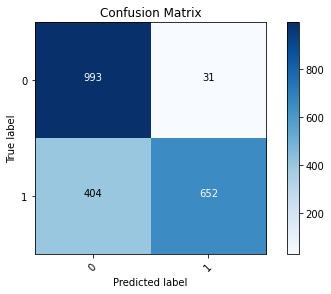

In [ ]:
plot_confusion_matrix(cm=cm,classes=[0,1] ,title='Confusion Matrix')

(3,)
(3,)


Text(0, 0.5, 'True Positive Rate')

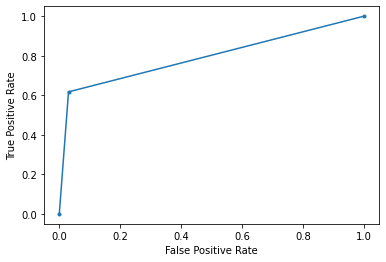

In [ ]:
from sklearn.metrics import roc_curve
#print(prediction.shape)
#prediction = prediction[:,1]
nb_fpr, nb_tpr,_= roc_curve(original,prediction)
#roc_auc = auc(lr_fpr, lr_tpr)
#print(nb_fpr)
#print(nb_tpr)
print(nb_fpr.shape)
print(nb_tpr.shape)
plt.plot(nb_fpr, nb_tpr,  marker='.', label='Naive Bayes' )

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend

# show the plot